## SIVR: Single City Visualization
Ref: [When zombies attack!: Mathematical modelling of an outbreak of zombie infection (Munz et al.)](https://www.loe.org/images/content/091023/Zombie%20Publication.pdf)

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib import animation
from IPython.display import HTML

In [3]:
# Define grid size
grid_size = 1000

# Define states
# 0: Empty, 1: Susceptible, 2: Infected, 3: Zombie, 4: Removed
EMPTY = 0
SUSCEPTIBLE = 1
INFECTED = 2
ZOMBIE = 3
REMOVED = 4

# Parameters (these can be adjusted as needed)
# Based on the Munz et al. paper but adapted for cellular automata
beta = 0.5       # Transmission probability (S to I when encountering Z)
rho = 0.3        # Rate at which infected become zombies
alpha = 0.1      # Rate at which zombies are destroyed when encountering S
zeta = 0.05      # Rate at which removed resurrect as zombies
delta = 0.01     # Natural death rate
pi = 0.02        # Birth rate (new susceptibles)

In [4]:
# Set up the initial grid
def initialize_grid(grid_size, initial_density=0.3):
    """Initialize the grid with susceptible population and a single zombie"""
    grid = np.zeros((grid_size, grid_size), dtype=int)

    # Add susceptible population randomly with initial_density
    for i in range(grid_size):
        for j in range(grid_size):
            if np.random.random() < initial_density:
                grid[i, j] = SUSCEPTIBLE

    # # Place a single zombie at the center
    # center = grid_size // 2
    # grid[center, center] = ZOMBIE

    return grid


# Define the update rules
def update_grid(grid):
    """Update the grid according to zombie infection rules"""
    new_grid = grid.copy()
    rows, cols = grid.shape

    for i in range(rows):
        for j in range(cols):
            # Get the state of the current cell
            state = grid[i, j]

            # Get the states of neighboring cells (Moore neighborhood)
            neighbors = []
            for di in [-1, 0, 1]:
                for dj in [-1, 0, 1]:
                    if di == 0 and dj == 0:
                        continue  # Skip the center cell
                    ni, nj = (i + di) % rows, (j + dj) % cols  # Wrap around boundaries
                    neighbors.append(grid[ni, nj])

            # Count neighbors by state
            zombie_neighbors = neighbors.count(ZOMBIE)
            susceptible_neighbors = neighbors.count(SUSCEPTIBLE)

            # Apply state transition rules:

            # Empty cells can become Susceptible (birth rate)
            if state == EMPTY:
                if np.random.random() < pi:
                    new_grid[i, j] = SUSCEPTIBLE

            # Susceptible cells can become Infected or Removed
            elif state == SUSCEPTIBLE:
                # Infection from zombie neighbors
                if (
                    zombie_neighbors > 0
                    and np.random.random() < beta * zombie_neighbors / 8
                ):
                    new_grid[i, j] = INFECTED
                # Natural death
                elif np.random.random() < delta:
                    new_grid[i, j] = REMOVED

            # Infected cells become zombies or die naturally
            elif state == INFECTED:
                if np.random.random() < rho:
                    new_grid[i, j] = ZOMBIE
                elif np.random.random() < delta:
                    new_grid[i, j] = REMOVED

            # Zombies can be destroyed when encountering susceptibles
            elif state == ZOMBIE:
                if (
                    susceptible_neighbors > 0
                    and np.random.random() < alpha * susceptible_neighbors / 8
                ):
                    new_grid[i, j] = REMOVED
                # Zombies also move randomly
                elif np.random.random() < 0.5:  # 50% chance to move
                    # Choose a random direction
                    direction = np.random.randint(0, 8)
                    di, dj = [
                        (-1, -1),
                        (-1, 0),
                        (-1, 1),
                        (0, -1),
                        (0, 1),
                        (1, -1),
                        (1, 0),
                        (1, 1),
                    ][direction]
                    ni, nj = (i + di) % rows, (j + dj) % cols

                    # Move only if the target cell is EMPTY
                    if grid[ni, nj] == EMPTY:
                        new_grid[i, j] = EMPTY
                        new_grid[ni, nj] = ZOMBIE

            # Removed cells can resurrect as zombies
            elif state == REMOVED:
                if np.random.random() < zeta:
                    new_grid[i, j] = ZOMBIE

    return new_grid


# Function to plot the grid
def plot_grid(grid, ax=None):
    """Plot the grid with different colors for each state"""
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 10))

    # Define colormap: Empty, Susceptible, Infected, Zombie, Removed
    cmap = ListedColormap(["black", "green", "yellow", "red", "gray"])

    ax.imshow(grid, cmap=cmap, vmin=0, vmax=4)
    ax.set_title("Zombie Outbreak Simulation - Tucson")
    ax.axis("off")

    return ax


# Function to track population counts over time
def count_population(grid):
    """Count the number of individuals in each state"""
    unique, counts = np.unique(grid, return_counts=True)
    population = dict(zip(unique, counts))

    # Ensure all states are represented
    for state in [EMPTY, SUSCEPTIBLE, INFECTED, ZOMBIE, REMOVED]:
        if state not in population:
            population[state] = 0

    return population


# Function to run simulation and animate results
def run_simulation(grid_size=1000, initial_density=0.3, num_frames=100, interval=100):
    """Run the simulation and create an animation"""
    grid = initialize_grid(grid_size, initial_density)

    # Create figure with two subplots
    fig = plt.figure(figsize=(15, 7))
    grid_ax = plt.subplot(121)
    plot_ax = plt.subplot(122)

    # Initial plot of the grid
    grid_img = grid_ax.imshow(
        grid,
        cmap=ListedColormap(["black", "green", "yellow", "red", "gray"]),
        vmin=0,
        vmax=4,
    )
    grid_ax.set_title("Zombie Outbreak Simulation")
    grid_ax.axis("off")

    # Initialize data storage for plots
    frames = [grid.copy()]
    population_history = [count_population(grid)]

    # Set up the population plot
    plot_ax.set_xlim(0, num_frames)
    plot_ax.set_ylim(0, grid_size * grid_size)
    plot_ax.set_xlabel("Time Step")
    plot_ax.set_ylabel("Population")
    plot_ax.set_title("Population Dynamics")

    # Line plots for each population type
    (empty_line,) = plot_ax.plot([], [], "k-", label="Empty")
    (susceptible_line,) = plot_ax.plot([], [], "g-", label="Susceptible")
    (infected_line,) = plot_ax.plot([], [], "y-", label="Infected")
    (zombie_line,) = plot_ax.plot([], [], "r-", label="Zombie")
    (removed_line,) = plot_ax.plot([], [], color="gray", linestyle="-", label="Removed")
    plot_ax.legend()

    # Run the simulation for the specified number of frames
    for i in range(num_frames):
        grid = update_grid(grid)
        frames.append(grid.copy())
        population_history.append(count_population(grid))

    # Convert population history to arrays for plotting
    steps = np.arange(len(population_history))
    empty_data = [p.get(EMPTY, 0) for p in population_history]
    susceptible_data = [p.get(SUSCEPTIBLE, 0) for p in population_history]
    infected_data = [p.get(INFECTED, 0) for p in population_history]
    zombie_data = [p.get(ZOMBIE, 0) for p in population_history]
    removed_data = [p.get(REMOVED, 0) for p in population_history]

    # Function to update the animation
    def update(frame):
        # Update the grid visualization
        grid_img.set_array(frames[frame])

        # Update the population plot
        empty_line.set_data(steps[: frame + 1], empty_data[: frame + 1])
        susceptible_line.set_data(steps[: frame + 1], susceptible_data[: frame + 1])
        infected_line.set_data(steps[: frame + 1], infected_data[: frame + 1])
        zombie_line.set_data(steps[: frame + 1], zombie_data[: frame + 1])
        removed_line.set_data(steps[: frame + 1], removed_data[: frame + 1])

        return (
            grid_img,
            empty_line,
            susceptible_line,
            infected_line,
            zombie_line,
            removed_line,
        )

    # Create the animation
    anim = animation.FuncAnimation(
        fig, update, frames=len(frames), interval=interval, blit=True
    )

    plt.tight_layout()
    return HTML(anim.to_jshtml())


# Function to run simulation and return summary data without animation
def run_simulation_data_only(grid_size=1000, initial_density=0.3, num_frames=100):
    """Run the simulation and return population data over time"""
    grid = initialize_grid(grid_size, initial_density)
    population_history = [count_population(grid)]

    for i in range(num_frames):
        grid = update_grid(grid)
        population_history.append(count_population(grid))

    return population_history


# Create a function to explore different parameter sets
def parameter_exploration():
    """Explore how different parameters affect the outbreak dynamics"""
    # Define parameter sets to explore
    parameter_sets = [
        {"beta": 0.3, "rho": 0.3, "alpha": 0.1, "zeta": 0.05, "label": "Baseline"},
        {
            "beta": 0.6,
            "rho": 0.3,
            "alpha": 0.1,
            "zeta": 0.05,
            "label": "High Transmission",
        },
        {
            "beta": 0.3,
            "rho": 0.6,
            "alpha": 0.1,
            "zeta": 0.05,
            "label": "Fast Zombification",
        },
        {
            "beta": 0.3,
            "rho": 0.3,
            "alpha": 0.3,
            "zeta": 0.05,
            "label": "Effective Defense",
        },
        {
            "beta": 0.3,
            "rho": 0.3,
            "alpha": 0.1,
            "zeta": 0.2,
            "label": "High Resurrection",
        },
    ]

    # Run simulations for each parameter set
    results = []
    for params in parameter_sets:
        # Set global parameters
        global beta, rho, alpha, zeta
        beta = params["beta"]
        rho = params["rho"]
        alpha = params["alpha"]
        zeta = params["zeta"]

        # Run simulation with smaller grid for speed
        history = run_simulation_data_only(grid_size=100, num_frames=100)
        results.append((params["label"], history))

    # Plot the results
    fig, ax = plt.subplots(len(results), 1, figsize=(12, 4 * len(results)))

    for i, (label, history) in enumerate(results):
        steps = np.arange(len(history))
        susceptible = [h.get(SUSCEPTIBLE, 0) for h in history]
        infected = [h.get(INFECTED, 0) for h in history]
        zombie = [h.get(ZOMBIE, 0) for h in history]
        removed = [h.get(REMOVED, 0) for h in history]

        ax[i].plot(steps, susceptible, "g-", label="Susceptible")
        ax[i].plot(steps, infected, "y-", label="Infected")
        ax[i].plot(steps, zombie, "r-", label="Zombie")
        ax[i].plot(steps, removed, color="gray", label="Removed")

        ax[i].set_title(f"Parameter Set: {label}")
        ax[i].set_xlabel("Time Step")
        ax[i].set_ylabel("Population")
        ax[i].legend()

    plt.tight_layout()
    plt.show()


# For better visualization of a smaller grid
def run_smaller_simulation(grid_size=100, initial_density=0.3, num_frames=200):
    """Run simulation on a smaller grid for faster visualization"""
    return run_simulation(grid_size, initial_density, num_frames)

## Demonstration

Animation size has reached 21063935 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


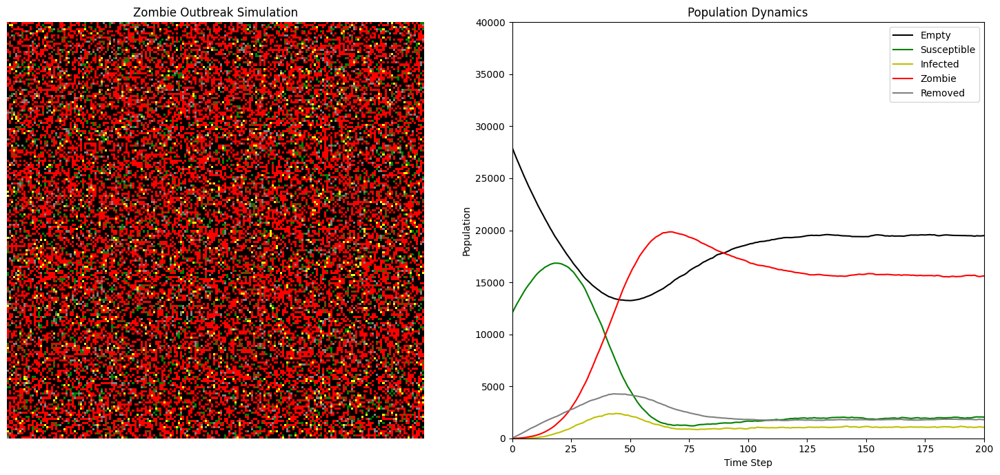

In [5]:
# Run the simulation with a smaller grid for demonstration
# You can adjust the grid_size parameter for the full 1000x1000 simulation
# Note: larger grid sizes will require more computational resources
run_smaller_simulation(grid_size=200, initial_density=0.3, num_frames=200)